# Deploy Stable Diffusion to Managed Endpoint

The aim of this notebook is to deploy the `score.py` as a [Managed Online Endpoint](https://learn.microsoft.com/en-us/azure/machine-learning/concept-endpoints-online?view=azureml-api-2) that is capable of handling several senarios of image generation with diffirent flavors of Stable Diffusion. It uses multiple pre-trained models to create different types of images, such as SD1.5, SDXL, text-to-image, image-to-image, single [controlnet](https://github.com/lllyasviel/ControlNet-v1-1-nightly), multi-controlnet, and inpainting tasks. 

## In this notebook:

- **Deployment of the Managed Online Endpoint**: The first section of this notebook, we focus on the deployment of a Managed Online Endpoint in your AML workspace.
- **Demonstrating different scneraios for this endpoint handles**: 
    - **Text-to-Image Generation**: Given a text prompt, the endpoint generates images that visually represent the given prompt. This can be useful for creating illustrations, designing logos, or visualizing ideas. It supports both Stable Diffusion 1.5 and SDXL.

    - **Image-to-Image Generation**: Given an input image and a text prompt, the endpoint generates new images that are variations of the input image based on the given text prompt. This can be useful for modifying existing images or exploring different styles and variations. It supports both Stable Diffusion 1.5 and SDXL.

    - **ControlNet-based Image Generation**: The endpoint can utilize ControlNets to guide the image generation process, providing more control over the output images.The model supports single controlnet and multi controlnets. We provided the example for Canny, Scribble, Depth and Shuffle. However, you can potentially add other controlnet models to this endpoint.

    - **Inpainting**: Given an input image and a mask, the endpoint fills the masked regions with content that is consistent with the surrounding area. This can be useful for removing unwanted objects from images or filling in missing areas. It supports Stable Diffusion 1.5.



## Requirements:

- A100 80 GB (`Standard_NC24ads_A100_v4`) to host the deployment. A100 40 or V100 also support these scenarios but the inference time will be higher.
- A Compute Instance to run this notebook. You need a light weight Compute Instance, such as `DS12_V2`
- SDK V2 to run this notebook. This notebook was entirely developed in `SDK-V2`. If you're running this on Compute Instance, no installation is needed, you just need to select the SDK-V2 runtime. For other environments, you need to install `azure-ai-ml` python package.

## What you need to know about `Score.py`

`Score.py` (located in `assets/score.py`) is the main logic that is deployed to the managed online endpoint to handle various SD techniques. designed for image generation tasks using . It begins by importing the necessary libraries, such as PyTorch, OpenCV, and PIL for image processing and manipulation, along with Transformer models from the Hugging Face library. It defines several functions to prepare and process images, such as applying Canny edge detection, handling shuffled content (styler), creating HED scribbles, and estimating depth. Additionally, it includes functions for loading and initializing pre-trained models, such as StableDiffusionPipeline, StableDiffusionControlNetPipeline, and ControlNetModel, with different schedulers like Euler Ancestral Discrete Scheduler.

The main function, `design()`, takes various parameters like prompt, image, seed, design type, and more, to generate images based on the specified design type, such as text-to-image, image-to-image, or inpainting. It handles different design types by calling the appropriate pre-trained models and preparing the necessary inputs. The `run()` function processes the raw input data, calls the `design()` function to generate images, and prepares the response to be returned. The response consists of a list of generated images converted into base64 encoded strings. Overall, this code base provides a comprehensive solution for generating images using state-of-the-art deep learning techniques and models.This supports various image generation scenarios based on the provided `design_type`. These scenarios include:
   
1. **Text-to-Image (TXT_TO_IMG)**: Given a text prompt, the function generates images related to the textual description. This is useful for creating visual representations of textual descriptions or ideas.  
   
2. **Image-to-Image (IMG_TO_IMG)**: Given an input image and a text prompt, the function generates new images by modifying the input image based on the provided prompt. This can be used for tasks like image editing, style transfer, or adding specific elements to existing images.  
   
3. **Text-to-Image with Stable Diffusion XL (TXT_TO_IMG_SDXL)**: This scenario is similar to Text-to-Image but uses a more advanced Stable Diffusion XL model for higher quality image generation. It first generates base images using the prompt and then refines them using the Stable Diffusion XL refiner model.  
   
4. **Image-to-Image with Stable Diffusion XL (IMG_TO_IMG_SDXL)**: This scenario is similar to Image-to-Image but uses a more advanced Stable Diffusion XL model for higher quality image generation. It refines the input image based on the provided prompt using the Stable Diffusion XL refiner model.  
   
5. **ControlNet with Canny Edges (CNET_CANNY)**: Given an input image and a text prompt, the function generates new images using a ControlNet model with Canny edge detection. This approach combines edge information with the textual prompt to guide the image generation process.  
   
6. **ControlNet with Canny Edges and Depth (CNET_CANNY_DEPTH)**: This scenario is similar to ControlNet with Canny Edges but also incorporates depth information. It generates images using a ControlNet model that takes into account Canny edges, depth information, and the provided prompt, resulting in more accurate and detailed image generation.  
   
7. **Inpainting (IN_PAINTING)**: Given an input image, a text prompt, and a mask, the function generates inpainted images, filling in the masked area based on the textual description. This is useful for tasks like image completion, object removal, or filling in missing regions in images.  
   
These scenarios offer a wide range of image generation capabilities, catering to different use cases and requirements. These capabilities could also chain to build more suffisticated use-cases.

## Managed Online Deployment:

In [1]:
# import required libraries

from azure.ai.ml import MLClient
from azure.ai.ml.entities import (
    ManagedOnlineEndpoint,
    ManagedOnlineDeployment,
    OnlineRequestSettings,
    Environment,
    CodeConfiguration,
    BuildContext,
    ProbeSettings,
)

from azure.ai.ml.entities import Model
from azure.ai.ml.constants import AssetTypes
from azure.identity import DefaultAzureCredential, InteractiveBrowserCredential

In [2]:
# enter details of your AML workspace
subscription_id = "<your-sub-id>"
resource_group = "<your-resourcegroup-name>"
workspace_name = "<your-AML-workspace-name>"

### Authenticating into AML Workspace

In [3]:
from azure.ai.ml import MLClient
from azure.identity import DefaultAzureCredential

# get a handle to the workspace
ml_client = MLClient(
    DefaultAzureCredential(), subscription_id, resource_group, workspace_name
)

### Helper function to deploy an Online Managed Endpoint

In [4]:
def deploy(endpoint_name, deployment_name, instance_type, folder_path, score_file, model, env, max_concurrent_requests_per_instance=1):
    # request_timeout_ms is set to the maximum of 90000 ms. This is to time out after 90 seconds. Keep in mind that 90 seconds is the maximum value you can set for this parameter.
    req_timeout = OnlineRequestSettings(request_timeout_ms=90000, max_queue_wait_ms=900000, max_concurrent_requests_per_instance=max_concurrent_requests_per_instance)

    deployment = ManagedOnlineDeployment(
        name=deployment_name,
        endpoint_name=endpoint_name,
        model=model,
        environment=env,
        code_configuration=CodeConfiguration(
            code=folder_path, scoring_script=score_file
        ),
        instance_type=instance_type,
        instance_count=1,
        request_settings=req_timeout,
        liveness_probe=ProbeSettings(
            failure_threshold=30,
            success_threshold=1,
            timeout=2,
            period=10,
            initial_delay=1000,
        ),
        readiness_probe=ProbeSettings(
            failure_threshold=10,
            success_threshold=1,
            timeout=10,
            period=10,
            initial_delay=1000,
        ),
    )

    return deployment

### Creation of AML Environment

To deploy an Online Managed Deployment, having an environment is a must. In this section, we register an AML Environment that contains all the necessary libraries to run the logics inside the `score.py`. The assets required for this environment is located in the `environments` folder.

Please note that, this step takes `20-30 minutes` for the first time to complete. To get the latest status or the logs, you can also view the ENvironments section of your Azure ML. If it took longer, you can click on the rebuild button on the `AzureML Studio` or call the `env.build()` function.

In [32]:
buildContext = BuildContext(path="./environments")
env_name = 'stable_diffusion_env'
env = None

try:
    env = list(ml_client.environments.list(name=env_name))[0]
except Exception as ex:
    print("The environment doesn't exist, creating a new environment ...")
finally:
    if env is None:
        env = Environment(
            build=buildContext,
            name=env_name,
            description='Stable diffusion environment'
        )

        ml_client.environments.create_or_update(env)

env.version



In [6]:
# Run if the build has failed for any reason or is taking unreasonably long!
# env.build()

### Registering a dummy model

In the `score.py` script, instead of fetching the models from the model registry, we retrieve them directly from HuggingFace. Said that, as model is a necessary parameter for the deployment of the `Manage Endpoint`, we register a dummy model that contains nothing but a text file.

In [31]:
model_name = "sd-model"

model = Model(
    path="model",
    type=AssetTypes.CUSTOM_MODEL,
    name=model_name,
    description="A dummy model for SD deployment.",
)
ml_client.models.create_or_update(model)

In [8]:
# Replace these values to better reflect your needs

endpoint_name = 'sd-endpoint'
deployment_name = 'stable-diffusion'
instance_type = 'Standard_NC24ads_A100_v4'
score_file = 'score.py'

In [9]:
# create an online endpoint
endpoint = ManagedOnlineEndpoint(
    name=endpoint_name,
    description="this is the stable diffusion online endpoint",
    auth_mode="key"
)


In [30]:
ml_client.online_endpoints.begin_create_or_update(endpoint).result()

In [29]:
deployment = deploy(endpoint_name=endpoint_name, deployment_name=deployment_name, instance_type=instance_type, folder_path="assets", score_file=score_file, model=model, env=env, max_concurrent_requests_per_instance=5)
ml_client.online_deployments.begin_create_or_update(deployment).result()


## Usage

In this section, we provide the instructions on how to use the endpoint. We submit post requests to the endpoint to generate the images. The endpoint returns images in bytes. Then we'll convert the bytes into Pillow Image type.

The payload of the request should look like this:

```json
{
    "data": {
        "prompt" : "<prompt>", // This is the most important parameter as allows to 
        "negative_prompt" : "<negative_prompt>", // The negative prompt that allows to enforce the things you don't like the model to produce. This has significant impact on the quality of the generated image
        "image_url": "<image_path>", // the URL of the reference image, this has to be a URL that is accessible by the endpoint
        "mask_image" : "<mask_image_url>", // Only for "IN_PAINTING" use-cases. The URL of the mask image used by the inpainting model, this has to be a URL that is accessible by the endpoint.
        "seed" : 0, // Torch seed value, keeping this can help you reproduce the result if other values stays the same
        "num_images_per_prompt" : 4,
        "strength" : 0.65, // Optional - Only for image to image scenarios (IMG_TO_IMG or TXT_TO_IMG_SDXL)
        "guidance_scale" : 10,
        "num_inference_steps" : 25,
        "design_type" : "CNET_CANNY", // Type of the design, it could be one of these ["TXT_TO_IMG", "IMG_TO_IMG", "TXT_TO_IMG_SDXL", "IMG_TO_IMG_SDXL", "CNET_CANNY", "CNET_CANNY_DEPTH", "IN_PAINTING"]
    }
}
```

## Formating Prompts

This example uses [Compel](https://github.com/damian0815/compel) for prompt weighting and blending. It allows to change the importance of the works in the prompt. For example, in this prompt, `a cat playing with a ball++ in the forest`, `ball` is weighted more compared to other tokens. Please read the documentation to learn more about this technique.

`Compel` current supports all SD 1.5 scenarios including Control Net but it only supports the SDXL base model. For the Refiner model, we had to fall back to the original prompt.

Find the right value for `api_key` and the endpoint `url` from your [AML Workspace](https://ml.azure.com/).

In [12]:
api_key = '<your-api-key>'
url = 'your-endpoint-url'


In [13]:
import urllib.request
import json
import os
import ssl
import io
from PIL import Image
import requests

def allowSelfSignedHttps(allowed):
    # bypass the server certificate verification on client side
    if allowed and not os.environ.get('PYTHONHTTPSVERIFY', '') and getattr(ssl, '_create_unverified_context', None):
        ssl._create_default_https_context = ssl._create_unverified_context

allowSelfSignedHttps(True)

if not api_key:
    raise Exception("A key should be provided to invoke the endpoint")
# The azureml-model-deployment header will force the request to go to a specific deployment.
# Remove this header to have the request observe the endpoint traffic rules
headers = {'Content-Type':'application/json', 'Authorization':('Bearer '+ api_key), 'azureml-model-deployment': deployment_name }


### Helper function

- `submit_requst`: it submits the payload and parses the result it into Pillow Images.
- `image_grid`: it displays the images into a grid
- `fetch_image_from_url` fetching an image by the image url

In [14]:
def submit_requst(data):
    """
    data: dictionary of images

    returns: list of images
    """
    body = str.encode(json.dumps(data))

    req = urllib.request.Request(url, body, headers)

    try:
        response = urllib.request.urlopen(req)

        result = response.read()
    except urllib.error.HTTPError as error:
        print("The request failed with status code: " + str(error.code))

        # Print the headers - they include the requert ID and the timestamp, which are useful for debugging the failure
        print(error.info())
        print(error.read().decode("utf8", 'ignore'))

    dic_images = json.loads(result.decode('utf-8'))

    from base64 import b64encode, b64decode

    li_images = []
    for image_key in dic_images:
        li_images.append(Image.open(io.BytesIO(b64decode(dic_images[image_key]))))

    return li_images

def image_grid(imgs, rows, cols):
    """
    imgs: list of images
    rows: number of rows in the grid
    cols: number of columns in the grid

    returns: a grid of images
    """
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    
    for i, img_o in enumerate(imgs):
        grid.paste(img_o, box=(i%cols*w, i//cols*h))
    return grid

def fetch_image_from_url(url):
    """
    url: url of the image

    returns: image
    """
    response = requests.get(url)
    # Ensure the request was successful
    response.raise_for_status()
    # Open the image using Pillow
    img = Image.open(io.BytesIO(response.content))
    return img

## Supported Scenarios

### Text to Image SD 1.5:

In [15]:
prompt = 'RAW photo, cinematic photo of a minimalist living room with sofa, coffee table, television, rug, armchair, curtains, bookshelf, Open floor plans, large windows, natural light, day time, sleek surfaces, dramatic photo 8k highly detailed HD'
negative_prompt = "(deformed, distorted, disfigured), poorly drawn, bad anatomy, wrong anatomy, extra limb, missing limb, floating limbs, (mutated hands and fingers), disconnected limbs, mutation, mutated, ugly, disgusting, blurry, amputation"


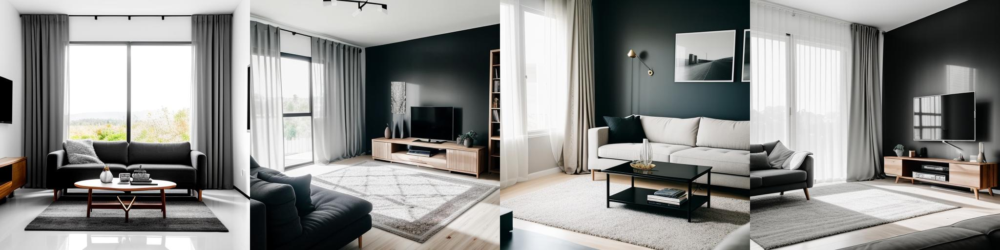

In [16]:
# Text to Image SD 1.5

data = {
    "data": {
        "prompt" : prompt,
        "negative_prompt" : negative_prompt,
        "seed" : 0,
        "num_images_per_prompt" : 4,
        "strength" : 0.55,
        "guidance_scale" : 10,
        "num_inference_steps" : 50,
        "design_type" : "TXT_TO_IMG",
    }
}

images = submit_requst(data)
image_grid(images, 1, len(images))


### Text to Image SDXL

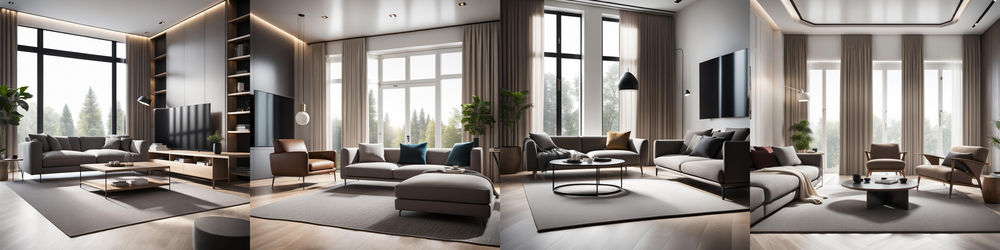

In [17]:
# Text to Image SDXL

data = {
    "data": {
        "prompt" : prompt,
        "negative_prompt" : negative_prompt,
        "seed" : 0,
        "num_images_per_prompt" : 4,
        "strength" : 0.3, # This parameter is used in the refiner step of the SDXL pipeline. This should be set in the lower range to keep the image close to the original image generated by the base model.
        "guidance_scale" : 10,
        "num_inference_steps" : 50,
        "design_type" : "TXT_TO_IMG_SDXL",
    }
}

images = submit_requst(data)
image_grid(images, 1, len(images))


### Image to Image SD 1.5

Image to image scenarios requires a base image to use as a reference and the model transforms the base image to a target state by applying the prompt.

Image source: "https://www.designcafe.com/blog/living-room-interiors/traditional-living-room-designs/"


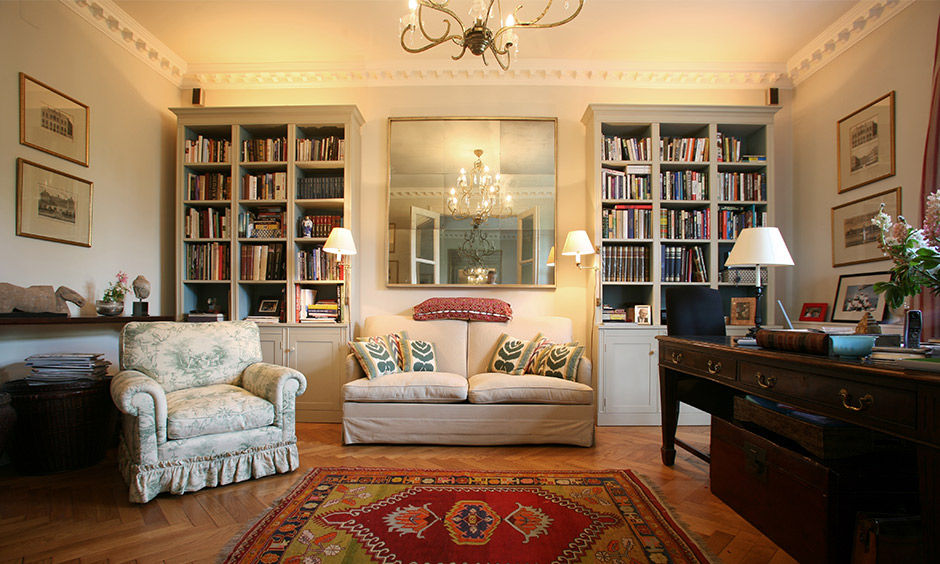

In [18]:
base_image = "https://media.designcafe.com/wp-content/uploads/2021/12/04204711/traditional-living-room-design-with-an-old-school-library.jpg"
print('Image source: "https://www.designcafe.com/blog/living-room-interiors/traditional-living-room-designs/"')

fetch_image_from_url(base_image)


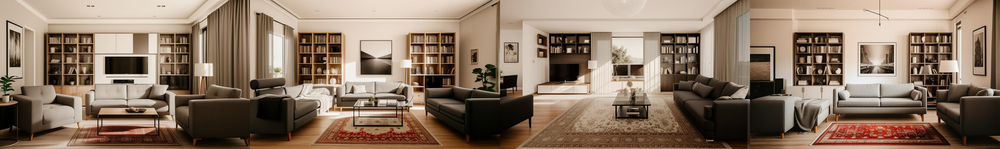

In [19]:
# Image to Image

data = {
    "data": {
        "prompt" : prompt,
        "negative_prompt" : negative_prompt,
        "image_url": base_image,
        "seed" : 0,
        "num_images_per_prompt" : 4,
        "strength" : 0.65,
        "guidance_scale" : 10,
        "num_inference_steps" : 50,
        "design_type" : "IMG_TO_IMG",
    }
}

images = submit_requst(data)
image_grid(images, 1, len(images))


### Image to Image SDXL


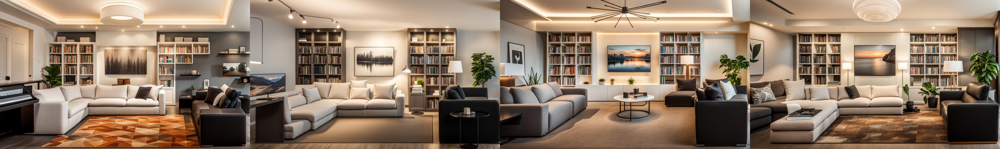

In [20]:
# Image to Image SDXL

data = {
    "data":
        {
            "prompt" : prompt,
            "negative_prompt" : negative_prompt,
            "image_url": base_image,
            "seed" : 0,
            "num_images_per_prompt" : 4,
            "strength" : 0.65,
            "guidance_scale" : 10,
            "num_inference_steps" : 50,
            "design_type" : "IMG_TO_IMG_SDXL",
        }
}

images = submit_requst(data)
image_grid(images, 1, len(images))


### Image to Image Controlnet Canny


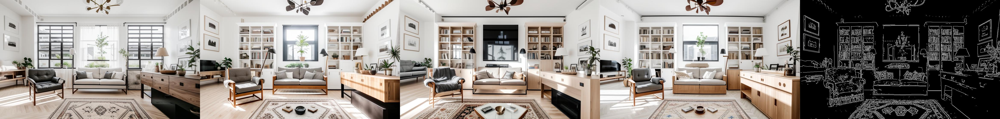

In [21]:
# Image to Image Controlnet Canny

data = {
    "data": {
        "prompt" : prompt,
        "negative_prompt" : negative_prompt,
        "image_url": base_image,
        "seed" : 0,
        "num_images_per_prompt" : 4,
        "strength" : 0.65,
        "guidance_scale" : 10,
        "num_inference_steps" : 50,
        "design_type" : "CNET_CANNY",
    }
}

images = submit_requst(data)
image_grid(images, 1, len(images))

### From a sketch to a polished result

One of the capabilities of the Canny or Scribble ControlNet models is the ability to transform sketches into finished designs. 

Image source: "https://c8.alamy.com/comp/RKGDAY/living-room-graphic-interior-vector-sketch-draw-RKGDAY.jpg"


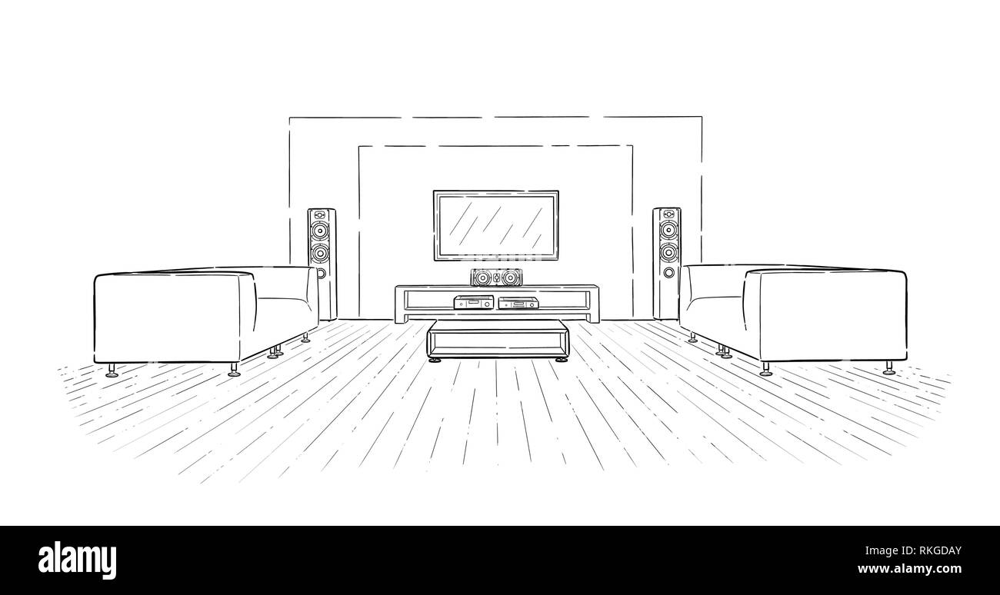

In [24]:
sketch_image = "https://c8.alamy.com/comp/RKGDAY/living-room-graphic-interior-vector-sketch-draw-RKGDAY.jpg"
print(f'Image source: "{sketch_image}"')

fetch_image_from_url(sketch_image)


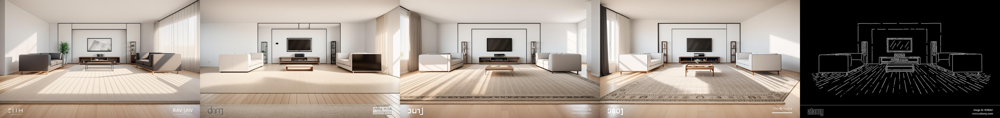

In [25]:
# Image to Image Controlnet Canny

data = {
    "data": {
        "prompt" : prompt,
        "negative_prompt" : negative_prompt,
        "image_url": sketch_image,
        "seed" : 0,
        "num_images_per_prompt" : 4,
        "strength" : 0.65,
        "guidance_scale" : 10,
        "num_inference_steps" : 50,
        "design_type" : "CNET_CANNY",
    }
}

images = submit_requst(data)
image_grid(images, 1, len(images))

### Image to Image - Multi Controlnet Canny + Depth

`Multi-ControlNet` scenarios allows for more control, for example in this use-case it stacks two layers of ControlNets to better keep the characteristics of the refrence image.

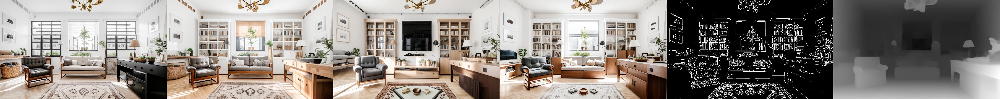

In [26]:
# Image to Image - Multi Controlnet Canny + Depth

data = {
    "data": {
        "prompt" : prompt,
        "negative_prompt" : negative_prompt,
        "image_url": base_image,
        "seed" : 0,
        "num_images_per_prompt" : 4,
        "strength" : 0.65,
        "guidance_scale" : 10,
        "num_inference_steps" : 50,
        "design_type" : "CNET_CANNY_DEPTH",
    }
}

images = submit_requst(data)
image_grid(images, 1, len(images))


### Inpainting SD 1.5

In this example, on a reference image, the model replaces the masked part of the image to reflect the prompt

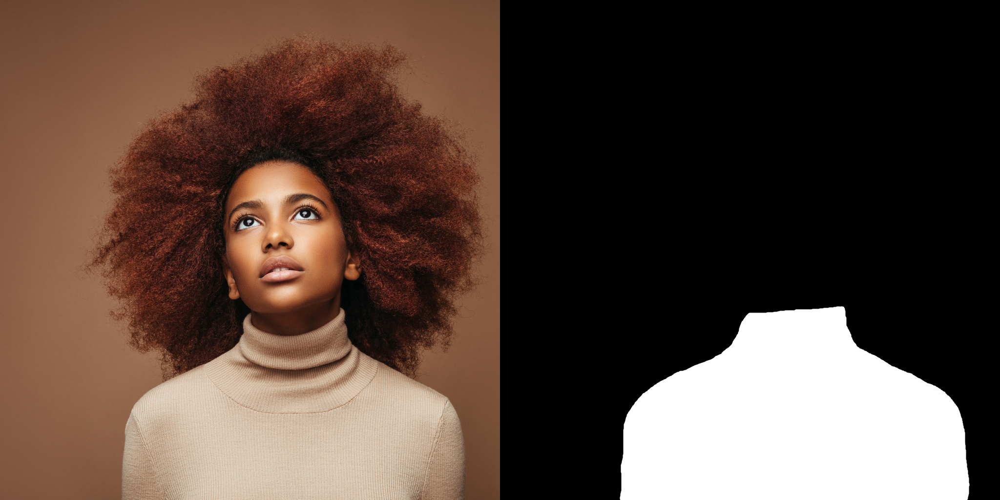

In [27]:
prompt = 'RAW Photo, (black jacket)++'

image_url = "https://raw.githubusercontent.com/Azure/gen-cv/main/sdxl-azureml/no-smile-1024.png"
mask_image_url = "https://raw.githubusercontent.com/Azure/gen-cv/main/sdxl-azureml/no-smile-big-mask.png"
ref_image = fetch_image_from_url(image_url)
mask_image = fetch_image_from_url(mask_image_url)
images = [ref_image, mask_image]
image_grid(images, 1, len(images))


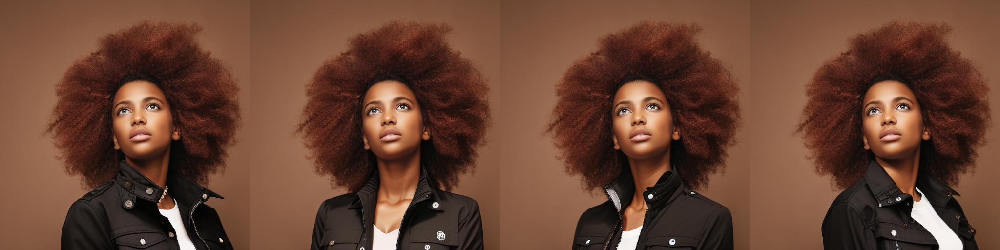

In [28]:
# Inpainting

data = {
    "data": {
            "prompt" : prompt,
            "negative_prompt" : negative_prompt,
            "image_url" : image_url,
            "mask_image" : mask_image_url,
            "seed" : 0,
            "num_images_per_prompt" : 4,
            "strength" : 0.65,
            "guidance_scale" : 10,
            "num_inference_steps" : 50,
            "design_type" : "IN_PAINTING",
    }
}

images = submit_requst(data)
image_grid(images, 1, len(images))